# Basic Version trained from scratch
For this approach, it will be used a pretrained DenseNet201, but without pretrained weights, being trained from scratch.

In [18]:
import os

DATA_DIR = "../data/"
IMG_DIR = DATA_DIR + "/images/"
ANNOTATION_DIR = DATA_DIR + "/annotations/"
SPLITS_DIR = DATA_DIR + "/dl-split/"
OUT_DIR = "./out/basic_scratch"

os.makedirs(OUT_DIR, exist_ok=True)

SEED = 42

# Utility Function

In [2]:
import matplotlib.pyplot as plt
def plot_training_history(train_history, val_history, model_name, phase_name, out_dir):
    fig, (loss_ax, acc_ax) = plt.subplots(figsize=(12, 8), nrows=2)
    fig.suptitle(f"{model_name} - {phase_name} History")
    loss_ax.set_title("Cross Entropy Loss")
    loss_ax.plot(train_history["loss"], label="train")
    loss_ax.plot(val_history["loss"], label="val")
    loss_ax.legend(loc="best")

    acc_ax.set_title("Classification accuracy")
    acc_ax.plot(train_history["accuracy"], label="train")
    acc_ax.plot(val_history["accuracy"], label="val")
    loss_ax.legend(loc="best")

    plt.tight_layout()

    fig.savefig(f"{out_dir}/{model_name}_{phase_name}_history.png", dpi=150, bbox_inches='tight')

    return fig

## Load Dataset

In [3]:
# Fetching pre-defined splits
train_split = []
test_split = []

with open(SPLITS_DIR + "/train.txt") as train_split_f:
    train_split = [line.strip("\n") for line in train_split_f.readlines()]

with open(SPLITS_DIR + "/test.txt") as test_split_f:
    test_split = [line.strip("\n") for line in test_split_f.readlines()]

In [4]:
# Label mapping
label_encode_map = {
    "background": -100,
    "trafficlight": 0,
    "speedlimit": 1,
    "crosswalk": 2,
    "stop": 3,
}

label_decode_map = {
    -100: "background",
    0: "trafficlight",
    1: "speedlimit",
    2: "crosswalk",
    3: "stop",
}

In [5]:
from datasets.road_sign_dataset import RoadSignDataset

# Training dataset
training_data = RoadSignDataset(
    img_names=train_split,
    img_dir=IMG_DIR,
    annotation_dir=ANNOTATION_DIR,
    classes=label_encode_map,
    is_train=True,
    multilabel=False
)

# Test dataset
testing_data = RoadSignDataset(
    img_names=test_split,
    img_dir=IMG_DIR,
    annotation_dir=ANNOTATION_DIR,
    classes=label_encode_map,
    is_train=False,
    multilabel=False,
)

# Split training dataset into train and validation splits

In [6]:
import numpy as np
from torch.utils.data import SubsetRandomSampler

np.random.seed(SEED)

train_indices = list(range(len(training_data)))
np.random.shuffle(train_indices)
train_val_split = int(np.floor(0.2 * len(train_indices)))

train_idx, val_idx = train_indices[train_val_split:], train_indices[:train_val_split]
train_sampler = SubsetRandomSampler(train_idx)
val_sampler = SubsetRandomSampler(val_idx)

# Create Dataloaders

In [7]:
from torch.utils.data import DataLoader

BATCH_SIZE = 4 # Tested on 1050TI with 4GB (can load at least 64 as well, but doesn't make sense to use 64 with low amount of data)
NUM_WORKERS = 4

train_dataloader = DataLoader(
    dataset=training_data,
    sampler=train_sampler,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=False, # Must be False because we're using a random sampler already
    drop_last=True,
    collate_fn=training_data.collate_fn
)

val_dataloader = DataLoader(
    dataset=training_data,
    sampler=val_sampler,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKERS,
    shuffle=False, # Must be False because we're using a random sampler already
    drop_last=True,
    collate_fn=training_data.collate_fn
)

test_dataloader = DataLoader(
    dataset=testing_data,
    batch_size=1,
    num_workers=NUM_WORKERS,
    shuffle=False,
    drop_last=False,
    collate_fn=testing_data.collate_fn
)

# Model Definition

In [8]:
from torchvision import models
from torch import nn
from torchinfo import summary

MODEL_NAME = "BASIC_SCRATCH"
N_CLASSES = 4

def get_model(n_classes):
    model = models.densenet201(pretrained=False)
    in_features = model.classifier.in_features
    model.classifier = nn.Linear(
        in_features=in_features,
        out_features=n_classes,
        bias=True
    )

    return model

model = get_model(n_classes=N_CLASSES)

summary(model)

Layer (type:depth-idx)                   Param #
DenseNet                                 --
├─Sequential: 1-1                        --
│    └─Conv2d: 2-1                       9,408
│    └─BatchNorm2d: 2-2                  128
│    └─ReLU: 2-3                         --
│    └─MaxPool2d: 2-4                    --
│    └─_DenseBlock: 2-5                  --
│    │    └─_DenseLayer: 3-1             45,440
│    │    └─_DenseLayer: 3-2             49,600
│    │    └─_DenseLayer: 3-3             53,760
│    │    └─_DenseLayer: 3-4             57,920
│    │    └─_DenseLayer: 3-5             62,080
│    │    └─_DenseLayer: 3-6             66,240
│    └─_Transition: 2-6                  --
│    │    └─BatchNorm2d: 3-7             512
│    │    └─ReLU: 3-8                    --
│    │    └─Conv2d: 3-9                  32,768
│    │    └─AvgPool2d: 3-10              --
│    └─_DenseBlock: 2-7                  --
│    │    └─_DenseLayer: 3-11            53,760
│    │    └─_DenseLayer: 3-12     

# Define Optimizer, LR Scheduler, Loss function and Metric Scorer

In [9]:
from torch import optim
import torchmetrics

optimizer = optim.Adam(
    params=model.parameters(),
    lr=1e-3,
    betas=(0.9, 0.999),
    weight_decay=5e-4,
    amsgrad=True
)

lr_scheduler = optim.lr_scheduler.ExponentialLR(
    optimizer=optimizer,
    gamma=0.9
)

loss_fn = nn.CrossEntropyLoss(ignore_index=label_encode_map['background'])

metric_scorer = torchmetrics.Accuracy(
    threshold=0.5,
    num_classes=N_CLASSES,
    average="micro",
    ignore_index=-100
)

# Define Epoch Iteration

In [10]:
import torch
import torch.nn.functional as F
from tqdm import tqdm

def epoch_iter(dataloader, model, loss_fn, device, is_train = True, optimizer=None, lr_scheduler=None):
    if is_train:
        assert optimizer is not None, "When training, please provide an optimizer."
      
    num_batches = len(dataloader)

    if is_train:
        model.train()
    else:
        model.eval()

    probs = []
    preds = []
    expected_labels = []
    imageIds = []

    total_loss = 0.0

    with torch.set_grad_enabled(is_train):
        for _batch, (X, y) in enumerate(tqdm(dataloader)):
            labels = y["labels"]
            ids = y["imageIds"]

            X, y = X.to(device), labels.to(device)

            pred = model(X)
            loss = loss_fn(pred, y)

            if is_train:
                optimizer.zero_grad()
                loss.backward()
                optimizer.step()
            
            total_loss += loss.item()

            prob = F.softmax(pred, dim=1)
            final_pred = torch.argmax(prob, dim=1)

            probs.extend(prob.detach().cpu().numpy())
            preds.extend(final_pred.detach().cpu().numpy())
            expected_labels.extend(y.detach().cpu().numpy())
            imageIds.extend([f"road{imageId}" for imageId in ids.detach().cpu().numpy()])

        if is_train and lr_scheduler is not None:
            lr_scheduler.step()
    

    return (expected_labels, preds, probs, imageIds), total_loss / num_batches

# Train Model

In [11]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

print(f"Using device: {device}")

Using device: cuda:0


In [12]:
NUM_EPOCHS = 30

model.to(device)
# model.features.requires_grad_(False) # Freeze feature layer

train_history = {
    "loss": [],
    "accuracy": [],
}

val_history = {
    "loss": [],
    "accuracy": [],
}

best_val_loss = np.inf
best_val_accuracy = 0
best_epoch = -1

print(f"Starting {MODEL_NAME} training...")

for epoch in range(1, NUM_EPOCHS + 1):
    print(f"Epoch[{epoch}/{NUM_EPOCHS}]")
    (train_target, train_preds, train_probs, _), train_loss = epoch_iter(
        dataloader=train_dataloader,
        model=model,
        loss_fn=loss_fn,
        device=device,
        is_train=True,
        optimizer=optimizer,
        lr_scheduler=lr_scheduler
    )

    train_accuracy = metric_scorer(torch.tensor(np.array(train_probs)), torch.tensor(np.array(train_target))).item()
    print(f"Training loss: {train_loss:.3f}\t Training micro accuracy: {train_accuracy:.3f}")

    (val_target, val_preds, val_probs, _), val_loss = epoch_iter(
        dataloader=val_dataloader,
        model=model,
        loss_fn=loss_fn,
        device=device,
        is_train=False,
    )

    val_accuracy = metric_scorer(torch.tensor(np.array(val_probs)), torch.tensor(np.array(val_target))).item()
    print(f"Validation loss: {val_loss:.3f}\t Validation micro accuracy: {val_accuracy:.3f}")

    # Save best model
    if val_loss < best_val_loss:
        best_val_loss = val_loss
        best_val_accuracy = val_accuracy
        best_epoch = epoch
        save_dict = {"model": model.state_dict(), "optimizer": optimizer.state_dict(), "lr_scheduler": lr_scheduler.state_dict(), "epoch": epoch}
        torch.save(save_dict, f"{OUT_DIR}/{MODEL_NAME}_best_model.pth")

    # Save latest model
    save_dict = {"model": model.state_dict(), "optimizer": optimizer.state_dict(), "lr_scheduler": lr_scheduler.state_dict(), "epoch": epoch}
    torch.save(save_dict, f"{OUT_DIR}/{MODEL_NAME}_latest_model.pth")

    # Save loss and accuracy in history
    train_history["loss"].append(train_loss)
    train_history["accuracy"].append(train_accuracy)

    val_history["loss"].append(val_loss)
    val_history["accuracy"].append(val_accuracy)

    print("----------------------------------------------------------------")

print(
    f"\nFinished training..."
    f"\nBest epoch: {best_epoch}\t Validation loss on best epoch: {best_val_loss}\t Accuracy on best epoch: {best_val_accuracy}"
)

Starting BASIC_SCRATCH training...
Epoch[1/30]


100%|██████████| 122/122 [00:40<00:00,  3.02it/s]


Training loss: 0.990	 Training micro accuracy: 0.730


100%|██████████| 30/30 [00:05<00:00,  5.36it/s]


Validation loss: 0.799	 Validation micro accuracy: 0.761
----------------------------------------------------------------
Epoch[2/30]


100%|██████████| 122/122 [00:38<00:00,  3.16it/s]


Training loss: 0.921	 Training micro accuracy: 0.724


100%|██████████| 30/30 [00:05<00:00,  5.91it/s]


Validation loss: 1.898	 Validation micro accuracy: 0.623
----------------------------------------------------------------
Epoch[3/30]


100%|██████████| 122/122 [00:38<00:00,  3.18it/s]


Training loss: 0.888	 Training micro accuracy: 0.720


100%|██████████| 30/30 [00:05<00:00,  5.52it/s]


Validation loss: 2.692	 Validation micro accuracy: 0.646
----------------------------------------------------------------
Epoch[4/30]


100%|██████████| 122/122 [00:38<00:00,  3.16it/s]


Training loss: 0.853	 Training micro accuracy: 0.748


100%|██████████| 30/30 [00:05<00:00,  5.46it/s]


Validation loss: 1.017	 Validation micro accuracy: 0.693
----------------------------------------------------------------
Epoch[5/30]


100%|██████████| 122/122 [00:38<00:00,  3.18it/s]


Training loss: 0.861	 Training micro accuracy: 0.734


100%|██████████| 30/30 [00:05<00:00,  5.56it/s]


Validation loss: 1.674	 Validation micro accuracy: 0.646
----------------------------------------------------------------
Epoch[6/30]


100%|██████████| 122/122 [00:38<00:00,  3.17it/s]


Training loss: 0.867	 Training micro accuracy: 0.733


100%|██████████| 30/30 [00:05<00:00,  5.42it/s]


Validation loss: 0.870	 Validation micro accuracy: 0.764
----------------------------------------------------------------
Epoch[7/30]


100%|██████████| 122/122 [00:38<00:00,  3.15it/s]


Training loss: 0.797	 Training micro accuracy: 0.748


100%|██████████| 30/30 [00:05<00:00,  5.69it/s]


Validation loss: 0.783	 Validation micro accuracy: 0.737
----------------------------------------------------------------
Epoch[8/30]


100%|██████████| 122/122 [00:38<00:00,  3.19it/s]


Training loss: 0.783	 Training micro accuracy: 0.767


100%|██████████| 30/30 [00:05<00:00,  5.48it/s]


Validation loss: 1.713	 Validation micro accuracy: 0.757
----------------------------------------------------------------
Epoch[9/30]


100%|██████████| 122/122 [00:38<00:00,  3.18it/s]


Training loss: 0.824	 Training micro accuracy: 0.725


100%|██████████| 30/30 [00:05<00:00,  5.55it/s]


Validation loss: 0.901	 Validation micro accuracy: 0.741
----------------------------------------------------------------
Epoch[10/30]


100%|██████████| 122/122 [00:38<00:00,  3.19it/s]


Training loss: 0.798	 Training micro accuracy: 0.740


100%|██████████| 30/30 [00:05<00:00,  5.46it/s]


Validation loss: 0.825	 Validation micro accuracy: 0.711
----------------------------------------------------------------
Epoch[11/30]


100%|██████████| 122/122 [00:38<00:00,  3.19it/s]


Training loss: 0.788	 Training micro accuracy: 0.746


100%|██████████| 30/30 [00:06<00:00,  5.00it/s]


Validation loss: 1.116	 Validation micro accuracy: 0.698
----------------------------------------------------------------
Epoch[12/30]


100%|██████████| 122/122 [00:38<00:00,  3.17it/s]


Training loss: 0.819	 Training micro accuracy: 0.742


100%|██████████| 30/30 [00:05<00:00,  5.31it/s]


Validation loss: 0.776	 Validation micro accuracy: 0.732
----------------------------------------------------------------
Epoch[13/30]


100%|██████████| 122/122 [00:37<00:00,  3.22it/s]


Training loss: 0.747	 Training micro accuracy: 0.765


100%|██████████| 30/30 [00:05<00:00,  5.68it/s]


Validation loss: 0.907	 Validation micro accuracy: 0.708
----------------------------------------------------------------
Epoch[14/30]


100%|██████████| 122/122 [00:37<00:00,  3.22it/s]


Training loss: 0.761	 Training micro accuracy: 0.757


100%|██████████| 30/30 [00:05<00:00,  5.52it/s]


Validation loss: 0.813	 Validation micro accuracy: 0.708
----------------------------------------------------------------
Epoch[15/30]


100%|██████████| 122/122 [00:38<00:00,  3.18it/s]


Training loss: 0.750	 Training micro accuracy: 0.741


100%|██████████| 30/30 [00:05<00:00,  5.33it/s]


Validation loss: 0.840	 Validation micro accuracy: 0.714
----------------------------------------------------------------
Epoch[16/30]


100%|██████████| 122/122 [00:38<00:00,  3.17it/s]


Training loss: 0.754	 Training micro accuracy: 0.752


100%|██████████| 30/30 [00:05<00:00,  5.52it/s]


Validation loss: 0.702	 Validation micro accuracy: 0.759
----------------------------------------------------------------
Epoch[17/30]


100%|██████████| 122/122 [00:39<00:00,  3.11it/s]


Training loss: 0.763	 Training micro accuracy: 0.743


100%|██████████| 30/30 [00:05<00:00,  5.39it/s]


Validation loss: 0.833	 Validation micro accuracy: 0.759
----------------------------------------------------------------
Epoch[18/30]


100%|██████████| 122/122 [00:39<00:00,  3.09it/s]


Training loss: 0.742	 Training micro accuracy: 0.762


100%|██████████| 30/30 [00:05<00:00,  5.58it/s]


Validation loss: 1.148	 Validation micro accuracy: 0.772
----------------------------------------------------------------
Epoch[19/30]


100%|██████████| 122/122 [00:39<00:00,  3.11it/s]


Training loss: 0.709	 Training micro accuracy: 0.755


100%|██████████| 30/30 [00:05<00:00,  5.32it/s]


Validation loss: 1.053	 Validation micro accuracy: 0.728
----------------------------------------------------------------
Epoch[20/30]


100%|██████████| 122/122 [00:39<00:00,  3.10it/s]


Training loss: 0.683	 Training micro accuracy: 0.765


100%|██████████| 30/30 [00:05<00:00,  5.31it/s]


Validation loss: 0.889	 Validation micro accuracy: 0.750
----------------------------------------------------------------
Epoch[21/30]


100%|██████████| 122/122 [00:39<00:00,  3.10it/s]


Training loss: 0.680	 Training micro accuracy: 0.790


100%|██████████| 30/30 [00:05<00:00,  5.45it/s]


Validation loss: 0.934	 Validation micro accuracy: 0.730
----------------------------------------------------------------
Epoch[22/30]


100%|██████████| 122/122 [00:39<00:00,  3.09it/s]


Training loss: 0.683	 Training micro accuracy: 0.769


100%|██████████| 30/30 [00:05<00:00,  5.45it/s]


Validation loss: 1.477	 Validation micro accuracy: 0.721
----------------------------------------------------------------
Epoch[23/30]


100%|██████████| 122/122 [00:40<00:00,  3.00it/s]


Training loss: 0.658	 Training micro accuracy: 0.776


100%|██████████| 30/30 [00:05<00:00,  5.35it/s]


Validation loss: 1.908	 Validation micro accuracy: 0.737
----------------------------------------------------------------
Epoch[24/30]


100%|██████████| 122/122 [00:40<00:00,  3.01it/s]


Training loss: 0.665	 Training micro accuracy: 0.787


100%|██████████| 30/30 [00:05<00:00,  5.30it/s]


Validation loss: 2.520	 Validation micro accuracy: 0.757
----------------------------------------------------------------
Epoch[25/30]


100%|██████████| 122/122 [00:40<00:00,  3.01it/s]


Training loss: 0.692	 Training micro accuracy: 0.774


100%|██████████| 30/30 [00:05<00:00,  5.37it/s]


Validation loss: 4.466	 Validation micro accuracy: 0.793
----------------------------------------------------------------
Epoch[26/30]


100%|██████████| 122/122 [00:39<00:00,  3.10it/s]


Training loss: 0.664	 Training micro accuracy: 0.773


100%|██████████| 30/30 [00:05<00:00,  5.60it/s]


Validation loss: 1.401	 Validation micro accuracy: 0.769
----------------------------------------------------------------
Epoch[27/30]


100%|██████████| 122/122 [00:39<00:00,  3.10it/s]


Training loss: 0.664	 Training micro accuracy: 0.776


100%|██████████| 30/30 [00:05<00:00,  5.26it/s]


Validation loss: 2.484	 Validation micro accuracy: 0.743
----------------------------------------------------------------
Epoch[28/30]


100%|██████████| 122/122 [00:40<00:00,  3.03it/s]


Training loss: 0.617	 Training micro accuracy: 0.800


100%|██████████| 30/30 [00:05<00:00,  5.19it/s]


Validation loss: 2.208	 Validation micro accuracy: 0.737
----------------------------------------------------------------
Epoch[29/30]


100%|██████████| 122/122 [00:40<00:00,  3.00it/s]


Training loss: 0.660	 Training micro accuracy: 0.774


100%|██████████| 30/30 [00:05<00:00,  5.38it/s]


Validation loss: 2.352	 Validation micro accuracy: 0.766
----------------------------------------------------------------
Epoch[30/30]


100%|██████████| 122/122 [00:39<00:00,  3.08it/s]


Training loss: 0.602	 Training micro accuracy: 0.773


100%|██████████| 30/30 [00:05<00:00,  5.63it/s]


Validation loss: 2.169	 Validation micro accuracy: 0.746
----------------------------------------------------------------

Finished training...
Best epoch: 16	 Validation loss on best epoch: 0.7020732273658117	 Accuracy on best epoch: 0.7592592835426331


C:\Users\Ivo Saavedra\AppData\Local\Temp\ipykernel_18188\193648876.py:2: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


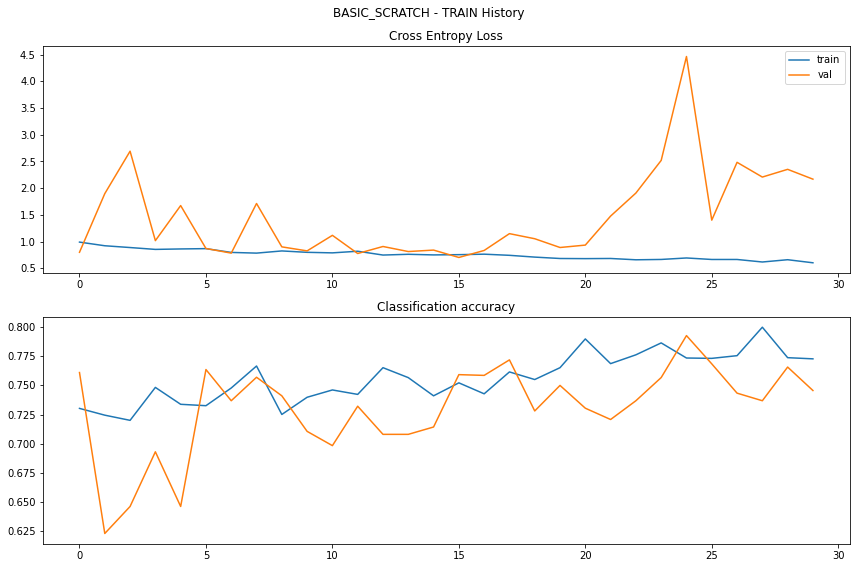

In [15]:
fig = plot_training_history(train_history=train_history, val_history=val_history, model_name=MODEL_NAME, phase_name="TRAIN", out_dir=OUT_DIR)
fig.show()

Clear GPU memory for guarantees

In [ ]:
import gc
model = None

gc.collect()
torch.cuda.empty_cache()
torch.cuda.mem_get_info(device)

(3543112091, 4294836224)

In [ ]:
!nvidia-smi

Fri Jun  3 09:46:32 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 512.95       Driver Version: 512.95       CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name            TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ... WDDM  | 00000000:01:00.0 Off |                  N/A |
| N/A   56C    P0    N/A /  N/A |     39MiB /  4096MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

Clean GPU memory again

In [ ]:
model = None

gc.collect()
torch.cuda.empty_cache()
torch.cuda.mem_get_info(device)

# Test the model

In [20]:
best_checkpoint = torch.load(f"{OUT_DIR}/{MODEL_NAME}_best_model.pth")
model = get_model(n_classes=N_CLASSES)
model.load_state_dict(best_checkpoint["model"])
best_checkpoint = None

model.to(device)


print("Loaded best fine-tuned model...")

Loaded best fine-tuned model...


In [21]:
(test_target, test_preds, test_probs, test_ids), test_loss = epoch_iter(
    dataloader=test_dataloader,
    model=model,
    loss_fn=loss_fn,
    device=device,
    is_train=False,
)

100%|██████████| 264/264 [00:19<00:00, 13.27it/s]


In [ ]:
np.unique(test_preds)

array([0, 1, 2, 3], dtype=int64)

In [22]:
test_metrics = torchmetrics.MetricCollection(
    metrics={
        "micro_accuracy": metric_scorer,
        "macro_accuracy": torchmetrics.Accuracy(
            threshold=0.5,
            num_classes=N_CLASSES,
            average="macro",
        ),
        "weighted_accuracy": torchmetrics.Accuracy(
            threshold=0.5,
            num_classes=N_CLASSES,
            average="weighted",
        ),
        "micro_f1_score": torchmetrics.F1Score(
            threshold=0.5,
            num_classes=N_CLASSES,
            average="micro",
        ),
        "macro_f1_score": torchmetrics.F1Score(
            threshold=0.5,
            num_classes=N_CLASSES,
            average="macro",
        ),
        "weighted_f1_score": torchmetrics.F1Score(
            threshold=0.5,
            num_classes=N_CLASSES,
            average="weighted",
        )
    }
)

test_probs_tensor = torch.tensor(np.array(test_probs))
test_target_tensor = torch.tensor(np.array(test_target))

test_metrics_scores = test_metrics(test_probs_tensor, test_target_tensor)

print(test_metrics_scores)

{'macro_accuracy': tensor(0.3813), 'macro_f1_score': tensor(0.3847), 'micro_accuracy': tensor(0.7235), 'micro_f1_score': tensor(0.7235), 'weighted_accuracy': tensor(0.7235), 'weighted_f1_score': tensor(0.6692)}


In [23]:
from sklearn.metrics import classification_report
print(classification_report(y_true=test_target, y_pred=test_preds, target_names=list(label_encode_map.keys())[1:]))

              precision    recall  f1-score   support

trafficlight       0.50      0.04      0.08        24
  speedlimit       0.76      0.92      0.83       192
   crosswalk       0.09      0.04      0.06        25
        stop       0.63      0.52      0.57        23

    accuracy                           0.72       264
   macro avg       0.50      0.38      0.38       264
weighted avg       0.66      0.72      0.67       264



In [24]:
from PIL import Image
def showErrors(imageIds, y_true, y_pred, limit=None, img_dir = "./"):
    N = limit if limit is not None else len(imageIds)
    N_COLS = 4
    N_ROWS = N // 4 + N % 4
    shown = 0
    fig = plt.figure(figsize=(8*N_COLS, 12*N_ROWS))
    for (imageId, correct, predicted) in zip(imageIds, y_true, y_pred):
        if correct == predicted:
            continue
        image = np.array(Image.open(f"{img_dir}/{imageId}.png").convert("RGB"))
        target_label = f"TRUE: {label_decode_map[correct]}"
        predicted_label = f"PRED: {label_decode_map[predicted]}"

        ax = fig.add_subplot(N_ROWS, N_COLS, shown + 1)
        ax.axis("off")
        ax.text(0, -8, imageId, fontsize=14, color="black")
        ax.text((len(imageId) + 1) * 8, -8, target_label, fontsize=14, color='green') # correct
        ax.text((len(imageId) + len(target_label) + 1) * 8, -8, predicted_label, fontsize=14, color='red')  # predicted
        ax.imshow(image)
        
        shown += 1

        if shown >= N:
            break
    plt.tight_layout()
    plt.show()

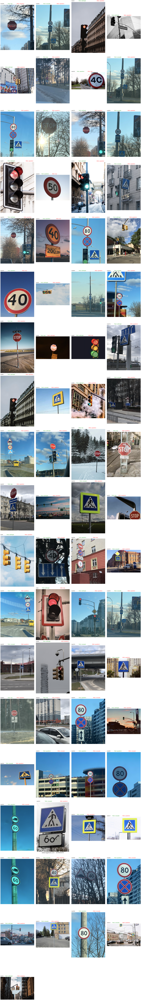

In [25]:
showErrors(test_ids, test_target, test_preds, limit=None, img_dir=IMG_DIR)